# Introduction
As an international student, mobility is never just about vacations or leisure. It shapes opportunities for education, work, and building a life across borders. The ability to move freely without bureaucratic hurdles often determines how easily students, professionals, and families can connect globally. Yet not all passports offer the same privileges, and their relative “power” can shift dramatically depending on global politics and diplomatic relations.

With this project I intend to explore *which countries have made the most dramatic improvements in passport power?* The question matters because it highlights how quickly international opportunities can expand or contract depending on a passport’s strength.

To answer them, I will analyze data from the global mobility ranking the **Henley Passport Index.** The data is from: [Here](https://github.com/rfordatascience/tidytuesday/blob/main/data/2025/2025-09-09/readme.md)

## Simple Data Exploration
I'll will present a simple data exploration.

In [102]:
## Simple data exploration
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
df= pd.read_csv('https://raw.githubusercontent.com/rfordatascience/tidytuesday/main/data/2025/2025-09-09/country_lists.csv')
df2= pd.read_csv('https://raw.githubusercontent.com/rfordatascience/tidytuesday/main/data/2025/2025-09-09/rank_by_year.csv')


In [103]:
df2

,code,country,region,rank,visa_free_count,year
0,AF,Afghanistan,ASIA,116,26,2021
1,AF,Afghanistan,ASIA,106,26,2020
2,AF,Afghanistan,ASIA,106,30,2018
3,AF,Afghanistan,ASIA,104,24,2017
4,AF,Afghanistan,ASIA,104,25,2016
...,...,...,...,...,...,...
3945,PS,Palestinian Territory,MIDDLE EAST,102,37,2019
3946,PS,Palestinian Territory,MIDDLE EAST,105,37,2022
3947,PS,Palestinian Territory,MIDDLE EAST,103,38,2023
3948,PS,Palestinian Territory,MIDDLE EAST,98,40,2024


## Data Visualisation

### PASSPORT POWER IMPROVEMENT  

Passport power change is defined as:  

$$
\Delta P = (C, \Delta V)
$$  

where:  
- $C$ is a country  
- $V$ is the number of visa-free destinations for $C$ in a given year  
- $\Delta V = V_{t_2} - V_{t_1}$ is the change in visa-free destinations between two years $t_1$ and $t_2$  

In our setting:  
- A **country** is the unit of observation  
- The **passport power** of a country in a given year is measured by its visa free count  
- The **improvement** $\Delta V$ captures how much mobility a passport has gained or lost over the period studied (2016–2025)  

**Example:**  
If Country A had **50 visa-free destinations in 2016** and **120 in 2025**, then:  

$$
\Delta V = 120 - 50 = +70
$$  

This means Country A improved by **70 visa-free destinations**, marking a dramatic expansion in passport power.  


### In my project I plan to graph $\Delta P$ for each country

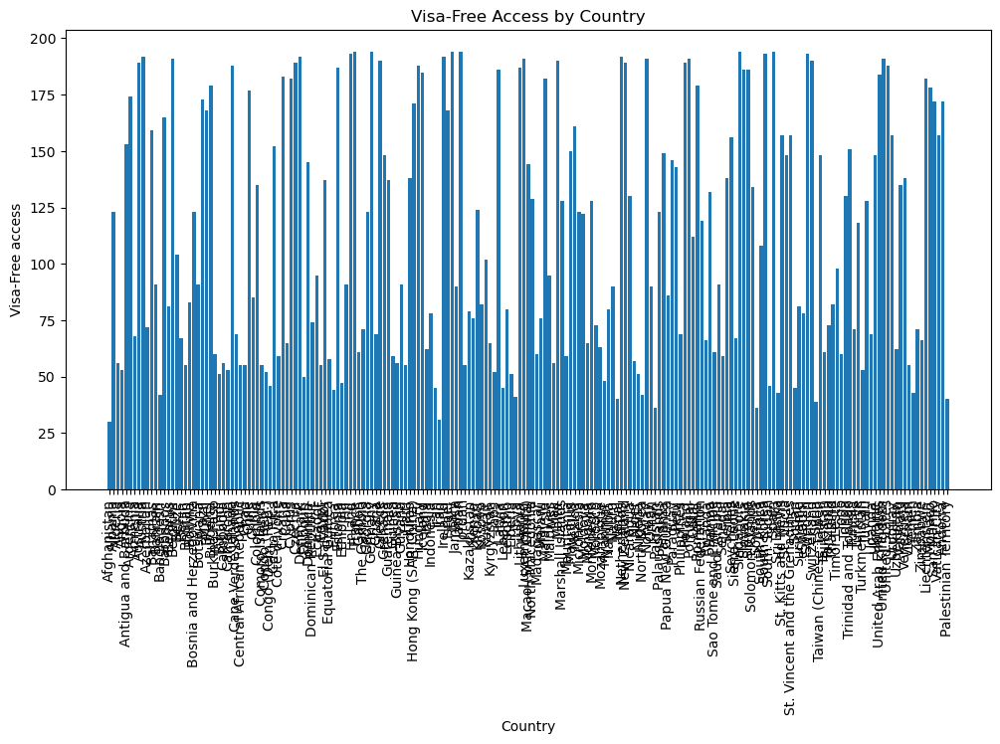

In [107]:
# | label: fig-label-to-make-reference
# | fig-cap: "Passport Visa Access"

##Bar Plot of country and visa free access
# Filter for the latest year
#latest = df2[df2['year'] == df2['year'].max()]

# Sort by visa_free_count for cleaner plot
#atest = latest.sort_values('visa_free_count', ascending=False)

# Bar plot
plt.figure(figsize=(12,6))
plt.bar(df2['country'], df2['visa_free_count'])
plt.xlabel('Country')
plt.ylabel('Visa-Free access')
plt.title("Visa-Free Access by Country")
plt.xticks(rotation=90)
plt.show()

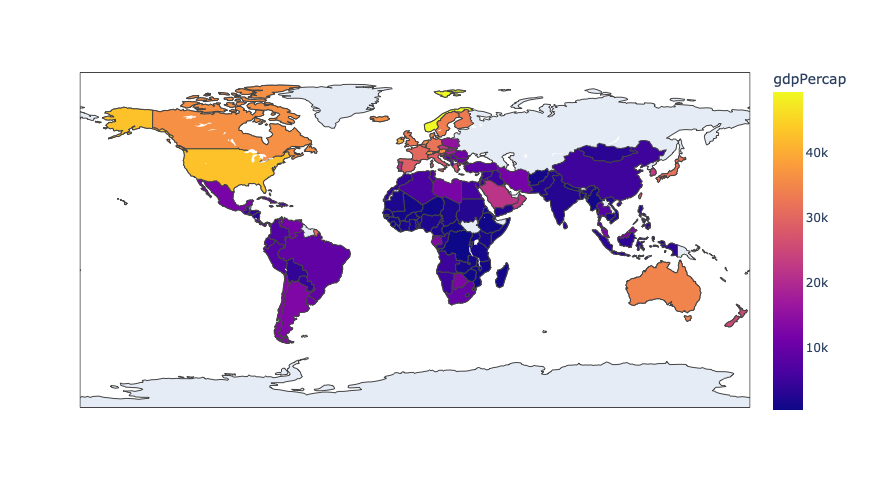

In [108]:
from urllib.request import urlopen
import json

import plotly.express as px

with urlopen('https://geoportal.un.org/arcgis/sharing/rest/content/items/d7caaff3ef4b4f7c82689b7c4694ad92/data') as response:
 countries = json.load(response)

df = px.data.gapminder().query("year == 2007")

fig = px.choropleth(df,
                    geojson=countries,  # to define the countries' borders
                    locationmode="ISO-3",  # to define the countries' borders
                    locations="iso_alpha",  # column containing the country name
                    color="gdpPercap",  # which column to show
                    height=500)
fig.show()

####### Research question

Clear enough

#### Data

- Explain what the Henley Passport Index is.

- Add a more explicit reference to the data set.

- No need to show columns that you do not use. If you choose to show something, explain it (e.g. `electronic_travel_authorisation`).

#### Data visualisation

- Consider making an interactive representation instead of a simple list of countries. You can adapt the following example. 
- Change the colours, size, etc.
- Do not forget to add a title and labels to the plot.
